In [4]:
# Import Libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
from time import mktime
import calendar
import csv
import sys
import os
import matplotlib.pyplot as plt
sys.path.insert(1, '..')
os.chdir('..')

In [5]:
# Load csv File
df = {'id': [], 'time': [], 'gl': []}

with open('./raw_data/Hall2018_processed_akhil.csv') as file:
    reader = csv.reader(file, delimiter=',')
    for row in reader:
        # check for NAs
        if 'NA' in row:
            continue
        
        if row[0] == 'id': # exclude row with column names
            continue
            
        df['id'].append(row[0]) # add current row's id
        dt = datetime.strptime(row[1], '%Y-%m-%d %H:%M:%S') # convert timestamps to datetime format so graphs dont break
        df['time'].append(dt)
        df['gl'].append(float(row[2])) # Convert glucose levels to floats

df = pd.DataFrame(df)
df

,id,time,gl
0,1636-69-001,2014-02-03 03:42:12,93.0
1,1636-69-001,2014-02-03 03:47:12,93.0
2,1636-69-001,2014-02-03 03:52:12,93.0
3,1636-69-001,2014-02-03 03:57:12,95.0
4,1636-69-001,2014-02-03 04:02:12,96.0
5,1636-69-001,2014-02-03 04:07:12,95.0
6,1636-69-001,2014-02-03 04:12:12,95.0
7,1636-69-001,2014-02-03 04:17:12,95.0
8,1636-69-001,2014-02-03 04:22:12,96.0
9,1636-69-001,2014-02-03 04:27:12,97.0


In [6]:
# sorting by time
sorted_df = pd.DataFrame(df.sort_values(by = ["time"])).reset_index()

In [7]:
# Grouping data by ID
IDs = []
for ID in df.id:
    if ID not in IDs:
        IDs.append(ID)

# Group Subject Data
subj_data = dict()
for ID in IDs:
    subj_data[ID] = df.loc[df['id'] == ID].reset_index()

In [8]:
# sorting by time
#sorted_subj_data = dict()
#for ID in IDs:
    #sorted_subj_data[ID] = pd.DataFrame(subj_data[ID].sort_values(by = ["time"])).reset_index()
    #sorted_subj_data[ID]

C:\Users\Akhil\Anaconda3\lib\site-packages\pandas\plotting\_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


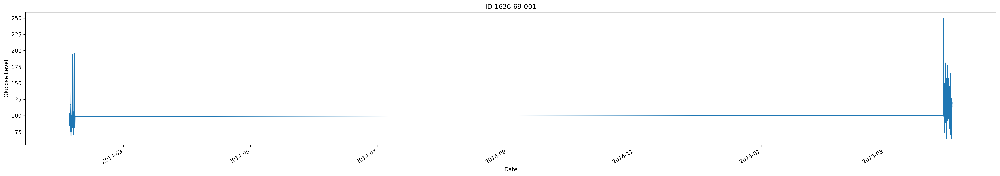

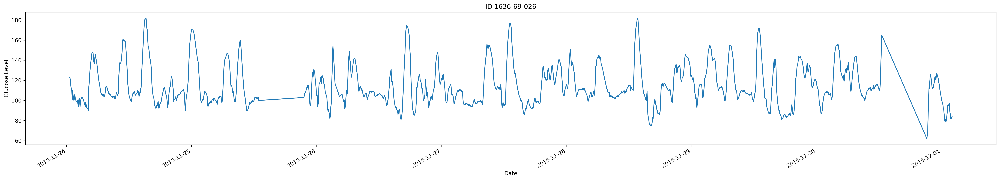

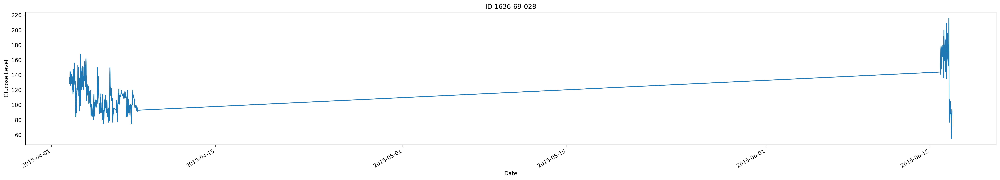

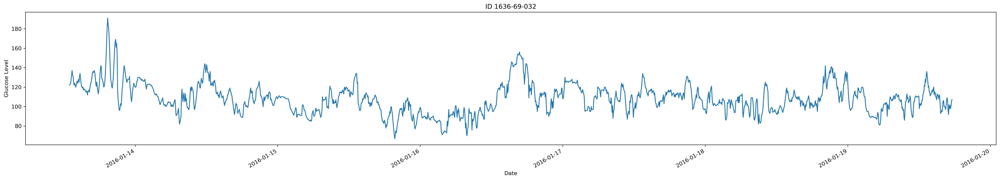

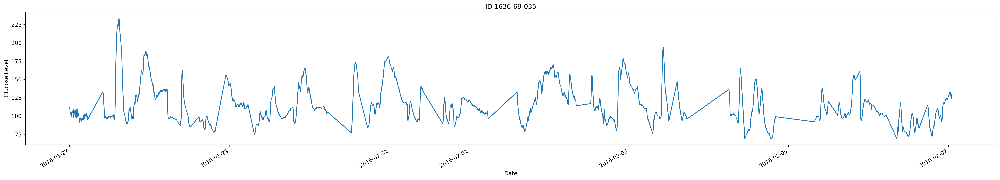

...

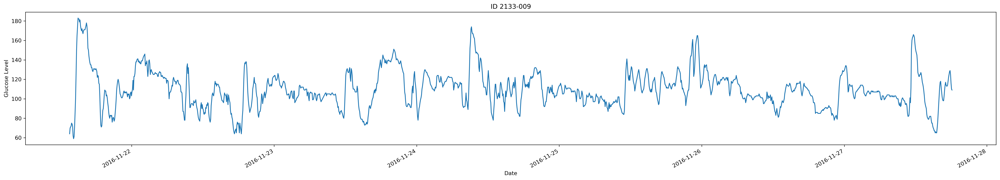

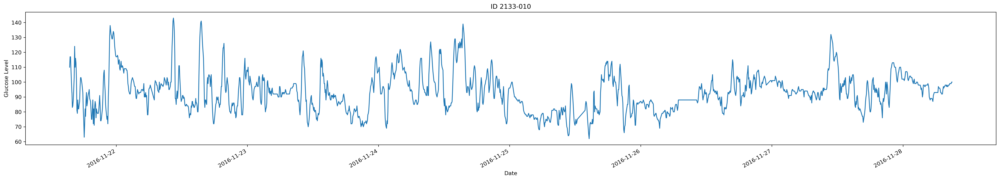

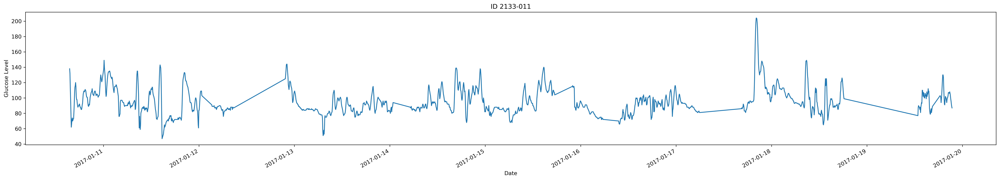

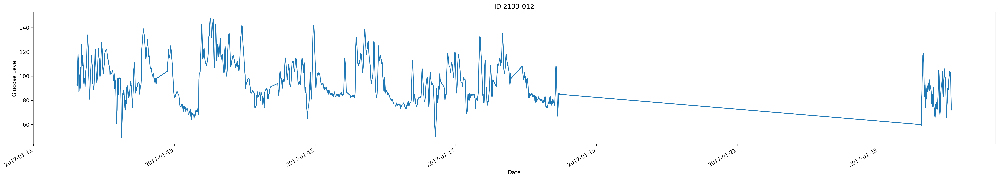

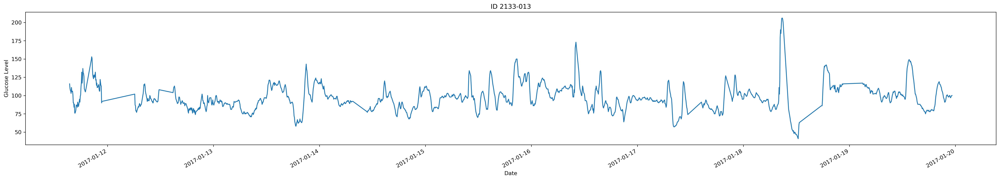

In [ ]:
# Plot by ID
for ID in IDs:
    x = subj_data[ID].time # Time for x-axis
    y = subj_data[ID].gl # Glucose for y-axis

    fig, ax = plt.subplots(figsize = (32,5), dpi = 300)
    ax.plot(x, y)
    plt.title("ID " + ID)
    plt.xlabel("Date")
    plt.ylabel("Glucose Level")
    
    fig.autofmt_xdate() # slant x-axis
    plt.show()

In [ ]:
# Frequency of reads is 5 min (dataset_properties.md), putting time intervals into buckets of 5 min interval
#subj_td = {"Subject 1": [], "Subject 2": [], "Subject 3": [], "Subject 4": [], "Subject 5": []}
subj_data_buckets = dict()
for ID in IDs:
    times = set()
    time_intervals = []
    data = subj_data[ID].time
    fmt = '%Y-%m-%d %H:%M:%S'
    for i in range(1, len(data)):
        t2 = datetime.strptime(str(data[i]), fmt)
        t1 = datetime.strptime(str(data[(i-1)]), fmt)
        td = float((t2 - t1).total_seconds() / 60)
        time_intervals.append(td)
        if td not in times:
            times.add(td)
    subj_data_buckets[ID] = [time_intervals, times]

In [20]:
#for ID in IDs:
#    fig, ax = plt.subplots(figsize = (8,4), dpi = 300)
#    ax.hist(subj_data_buckets[ID][0])
#    plt.title(ID)
#    plt.xlabel('Time (mins)')
#    plt.ylabel('Frequency')
#    plt.show()

In [21]:
subj_data_buckets_count = dict()

for ID in IDs:
    counts = {'6-10': 0, '10-15': 0, '15-20': 0, '20-25': 0, '25-30': 0, '30-35': 0, '35-40': 0, '40-45': 0, '45-50': 0, '50-55': 0, '55-60': 0,'>60': 0 }
    for time in subj_data_buckets[ID][0]:
        if time >= 6 and time <= 10:
            counts['6-10'] += 1
        elif time >= 10 and time <= 15:
            counts['10-15'] += 1
        elif time >= 15 and time <= 20:
            counts['15-20'] += 1
        elif time >= 20 and time <= 25:
            counts['20-25'] += 1
        elif time >= 25 and time <= 30:
            counts['25-30'] += 1
        elif time >= 30 and time <= 35:
            counts['30-35'] += 1
        elif time >= 35 and time <= 40:
            counts['35-40'] += 1
        elif time >= 40 and time <= 45:
            counts['40-45'] += 1
        elif time >= 45 and time <= 50:
            counts['45-50'] += 1
        elif time >= 50 and time <= 55:
            counts['50-55'] += 1
        elif time >= 55 and time <= 60:
            counts['55-60'] += 1
        elif time >= 60 :
            counts['>60'] += 1
    subj_data_buckets_count[ID] = counts

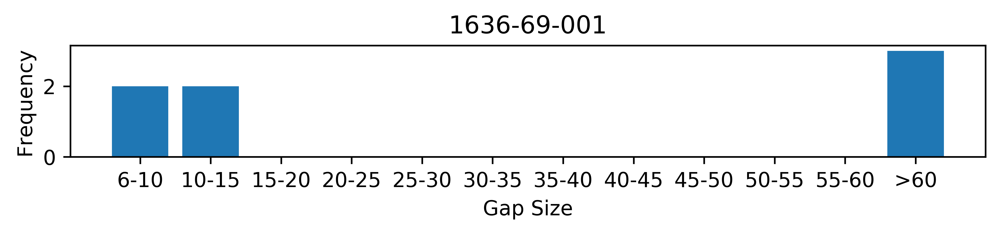

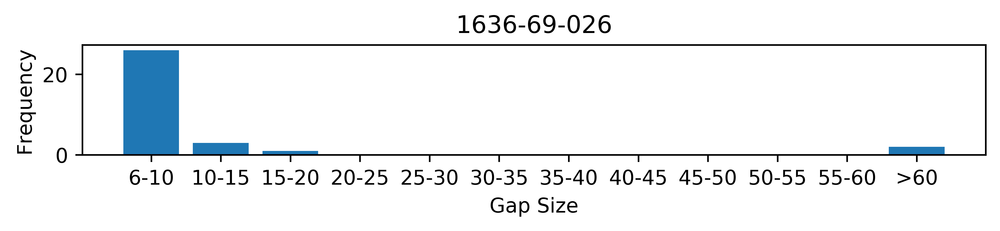

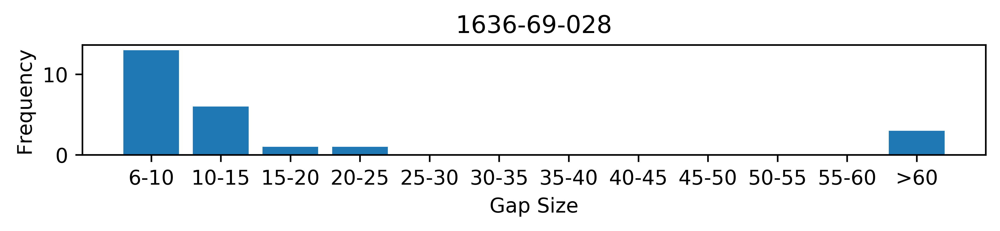

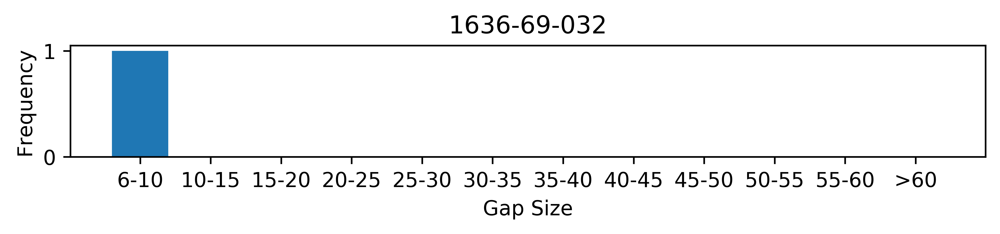

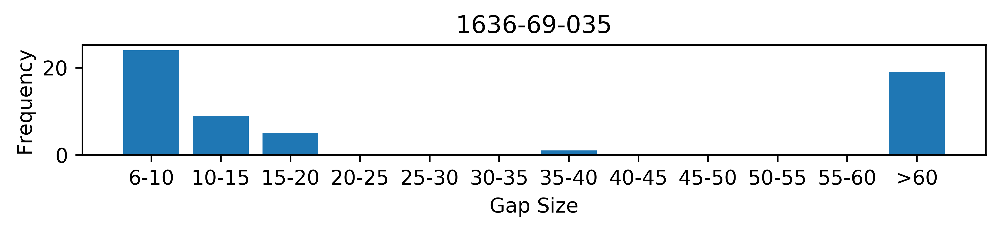

...

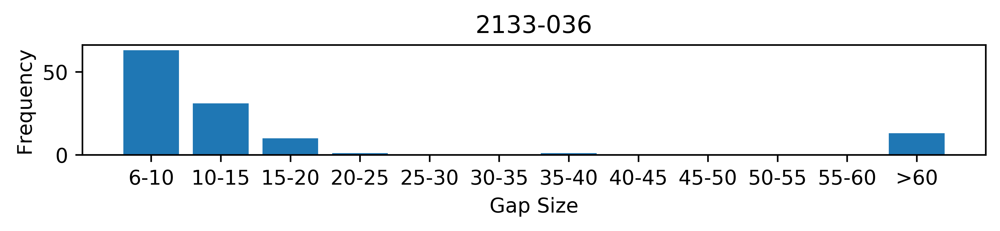

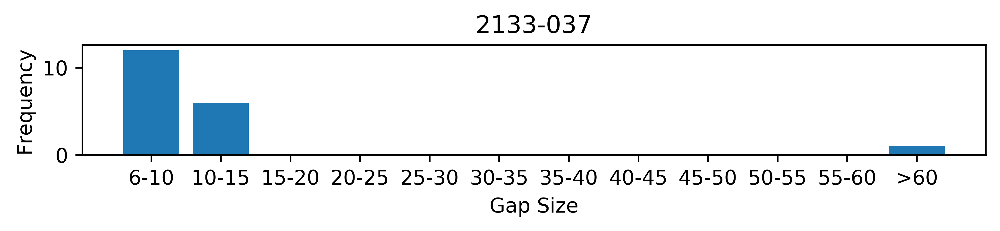

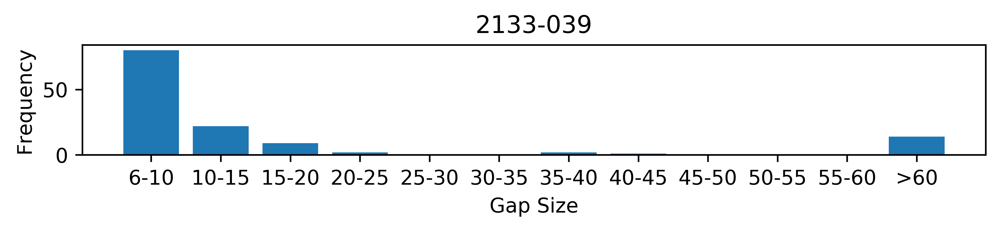

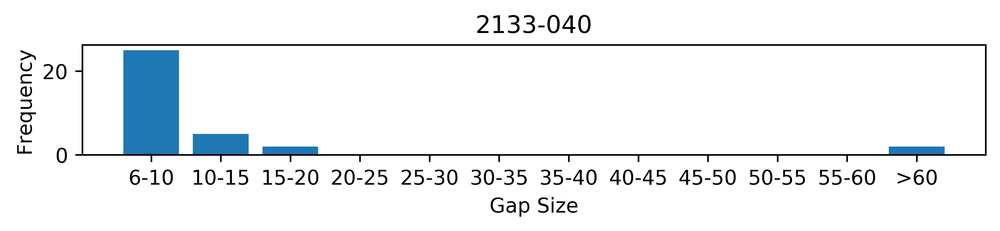

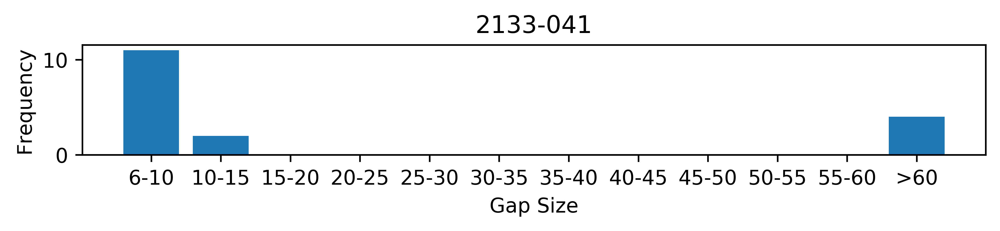

In [22]:
for ID in IDs:
    names = list(subj_data_buckets_count[ID].keys())
    freq = list(subj_data_buckets_count[ID].values())
    
    fig, ax = plt.subplots(figsize = (8, 1), dpi = 600)
    ax.bar(names, freq)
    plt.title(ID)
    plt.xlabel("Gap Size")
    plt.ylabel("Frequency")
    plt.show()